## Ellipse detection project 2022

In [ ]:
import Pkg

# activate parent environment
Pkg.activate(normpath(joinpath(@__DIR__, ".")))
Pkg.resolve()
Pkg.instantiate()
Pkg.status()

using DSP
using Colors
using Plots
using JuMP
using FileIO
using Colors
using ImageShow 
using LinearAlgebra

  Activating project at `c:\Users\lange\OneDrive\Projects\2024\2dme20-ellipse`
  No Changes to `C:\Users\lange\OneDrive\Projects\2024\2dme20-ellipse\Project.toml`
  No Changes to `C:\Users\lange\OneDrive\Projects\2024\2dme20-ellipse\Manifest.toml`
Precompiling project...
  ✓ ImageBase
  ✓ ImageShow
  ✓ PlotUtils
  ✓ PlotThemes
  ✓ RecipesPipeline
  ✓ Plots
  ✓ Plots → FileIOExt
  ✓ Plots → UnitfulExt
  8 dependencies successfully precompiled in 55 seconds. 178 already precompiled.

Status `C:\Users\lange\OneDrive\Projects\2024\2dme20-ellipse\Project.toml`
  [5ae59095] Colors v0.13.0
  [5789e2e9] FileIO v1.16.4
  [4e3cecfd] ImageShow v0.3.8
  [4076af6c] JuMP v1.23.4
  [91a5bcdd] Plots v1.40.9

## Load the image

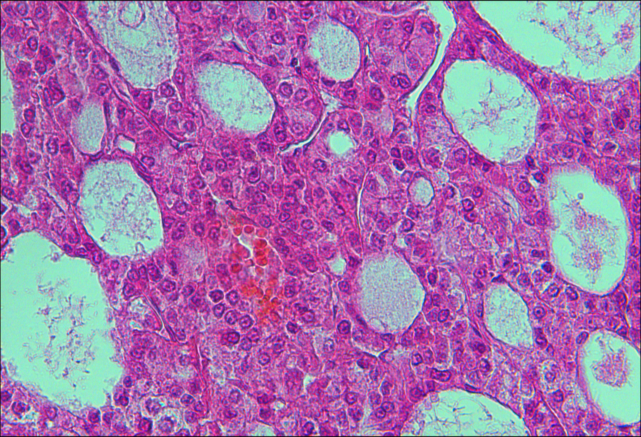

In [2]:
img = load("liver_tissue.jpg")

## Building the edge detector 

Mexican hat wavelet:

\begin{equation}
    \psi (x,y)={\frac {1}{\pi \sigma ^{4}}}\left(1-{\frac {1}{2}}\left({\frac {x^{2}+y^{2}}{\sigma ^{2}}}\right)\right)e^{-{\frac {x^{2}+y^{2}}{2\sigma ^{2}}}}
\end{equation}

In [11]:
# build the mexican hat filter
function mexican_hat_filter(n)
    filter = zeros(n, n)
    for i in 1:n
        for j in 1:n
            x = i - n/2
            y = j - n/2
            filter[i, j] = (1 - (x^2 + y^2) / (n^2)) * exp(-(x^2 + y^2) / (2 * n^2))
        end
    end
    return filter
end

# convert the image img to black and white 
function to_black_and_white(img::Matrix)
    bw_img = Matrix{Gray}(undef, size(img))
    for i in 1:size(img, 1)
        for j in 1:size(img, 2)
            bw_img[i, j] = Gray(img[i, j])
        end
    end
    return bw_img
end

to_black_and_white (generic function with 2 methods)

In [154]:
function canny_edge_detector(f_smooth::Matrix{Float64}, d1::Float64=0.1, d2::Float64=0.1)
    # Dimensions of the image
    rows, cols = size(f_smooth)
    
    # Preallocate arrays for gradient and Laplacian
    gradient_magnitude = zeros(Float64, rows, cols)
    laplacian_magnitude = zeros(Float64, rows, cols)
    edge_matrix = zeros(Bool, rows, cols)  # Binary matrix for edges
    
    # Sobel filters
    sobel_x = [-1 0 1; -2 0 2; -1 0 1]
    sobel_y = [-1 -2 -1; 0 0 0; 1 2 1]
    sobel_xx = [-1 2 -1; 2 -4 2; -1 2 -1]
    sobel_yy = [-1 2 -1; 2 -4 2; -1 2 -1]

    # Convolve the image with the Sobel filters
    gradient_x = conv(f_smooth, sobel_x)
    gradient_y = conv(f_smooth, sobel_y)

    # Compute the gradient magnitude
    gradient_magnitude = sqrt.(gradient_x.^2 + gradient_y.^2)

    # second derivative
    gradient_xx = conv(f_smooth, sobel_xx)
    gradient_yy = conv(f_smooth, sobel_yy)
    laplacian_magnitude = sqrt.(gradient_xx.^2 + gradient_yy.^2)

    # thresholding with d1, d2
    for i in 1:rows
        for j in 1:cols
            if gradient_magnitude[i, j] > d1 && laplacian_magnitude[i, j] < d2
                edge_matrix[i, j] = true
            end
        end
    end

    return edge_matrix, gradient_magnitude, laplacian_magnitude
end

canny_edge_detector (generic function with 3 methods)

## Apply filter

In [189]:
size(bw_img)

(1742, 2560)

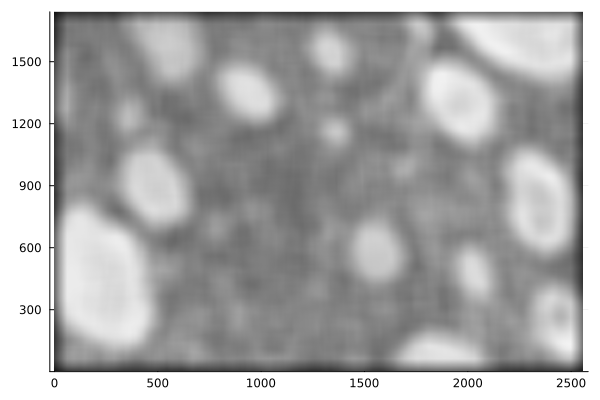

In [214]:
# Example usage
K = 126
bw_img = to_black_and_white(img)
filter = mexican_hat_filter(K)

# apply the filter to the image by convolution
filt_img = DSP.conv(Matrix{Float64}(bw_img), filter)
# cut off edges to make the image the same size as the original
N, M = size(filt_img)
filt_img = filt_img[Int(K/2)+1:N-Int(K/2), Int(K/2)+1:M-Int(K/2)]

# flip upside down
filt_img = filt_img[end:-1:1, :]
heatmap(filt_img, color=:grays, aspect_ratio=1, cbar=false)

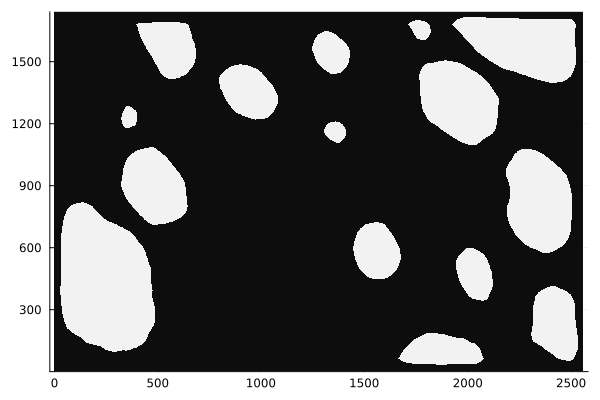

In [215]:
# apply thresholding to the filtered image
# rescale the image to 0-1
filt_img = (filt_img .- minimum(filt_img)) / (maximum(filt_img) - minimum(filt_img))
th_img = Matrix{Bool}([filt_img[i, j] > 0.7 ? 1.0 : 0.0 for i in 1:size(filt_img, 1), j in 1:size(filt_img, 2)])
heatmap(th_img, color=:grays, aspect_ratio=1, cbar=false)

## Apply thresholding (canny edge detector)

In [216]:
function link_edges(edge_image::Matrix; max_distance=2)
    """
    Links edges in a binary image to form closed shapes.
    
    Parameters:
    - edge_image: Binary image (output of an edge detector).
    - max_distance: Maximum distance to link edges.
    
    Returns:
    - Linked edge image as a binary array.
    """
    # Dimensions of the image
    rows, cols = size(edge_image)

    # Helper function to check if a coordinate is within bounds
    function in_bounds(x, y)
        return 1 <= x <= rows && 1 <= y <= cols
    end

    # Helper function to find neighbors of a pixel within a certain distance
    function get_neighbors(x, y, max_distance)
        neighbors = []
        for dx in -max_distance:max_distance
            for dy in -max_distance:max_distance
                if dx == 0 && dy == 0
                    continue
                end
                nx, ny = x + dx, y + dy
                if in_bounds(nx, ny) && edge_image[nx, ny]
                    push!(neighbors, (nx, ny))
                end
            end
        end
        return neighbors
    end

    # Create a copy of the edge image to modify
    linked_image = copy(edge_image)

    # Iterate through each pixel in the image
    for x in 1:rows
        for y in 1:cols
            if linked_image[x, y]
                # Get all neighbors within the maximum distance
                neighbors = get_neighbors(x, y, max_distance)

                # Connect this pixel to all neighbors by filling gaps
                for (nx, ny) in neighbors
                    for i in min(x, nx):max(x, nx)
                        for j in min(y, ny):max(y, ny)
                            linked_image[i, j] = true
                        end
                    end
                end
            end
        end
    end

    return linked_image
end

link_edges (generic function with 2 methods)

In [217]:
size(edges), size(img)

((1742, 1742), (1742, 2560))

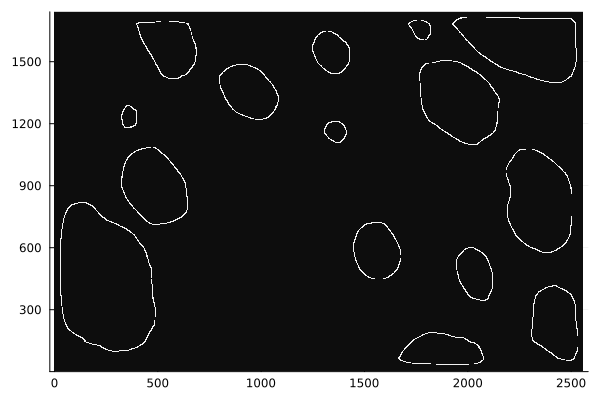

In [218]:
d1 = 0.3
d2 = 3.01

# Detect edges
edges, gradients, laplacians = canny_edge_detector(Matrix{Float64}(th_img), d1, d2)
linked_edges = link_edges(edges)

heatmap(linked_edges, color=:grays, aspect_ratio=1, cbar=false)

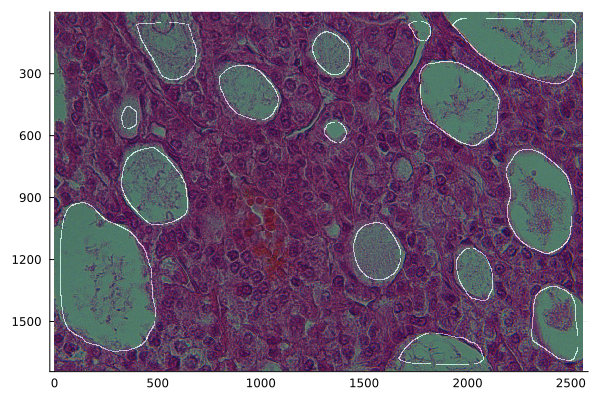

In [221]:
# overlay the edges on top of the original image
plt_res = heatmap(img, aspect_ratio=1, cbar=false)
heatmap!(plt_res, linked_edges[end:-1:1, :], color=:grays, aspect_ratio=1, cbar=false, alpha=0.5)
savefig(plt_res, "liver_tissue_edges.png")
display(plt_res)